In [1]:
import pandas as pd 
import numpy as np
import os
import sys

import networkx as nx

import datashader as ds
import datashader.transfer_functions as tf
from datashader.layout import forceatlas2_layout
from datashader.bundling import connect_edges, hammer_bundle
from colormap import *

# import from absolute directory
srcdir = '/Users/pengzhizhang/cellDancer/src'
sys.path.append(srcdir)

from turtle import color
from sklearn.neighbors import NearestNeighbors
import matplotlib.pyplot as plt
from sampling import *
import pandas as pd
from colormap import *
import random
import cdplt

In [3]:
# cellid 0-887
nsamples = len(sub_celltime)
cellembedding = load_raw_data[load_raw_data.gene_list == 
                          load_raw_data.gene_list[0]][['embedding1', 'embedding2', 'clusters']]

sub_cellembedding = cellembedding[celltime['sample']]

In [4]:
sub_data = pd.concat([sub_celltime, sub_cellembedding], axis=1)

In [261]:
def create_graph_KNN_based(data, n_neighbors, neighborhood_radius):
    
    from sklearn.neighbors import NearestNeighbors
    cell_embedding = data[['embedding1', 'embedding2']]
    neigh = NearestNeighbors(n_neighbors = n_neighbors, radius = neighborhood_radius)
    neigh.fit(cell_embedding)
    nn_graph = neigh.radius_neighbors_graph(cell_embedding)
    nn_array = nn_graph.toarray()
    edge_filter = np.triu(nn_array, k=1)
    
    # nn_array is effectively the edge list
    # Keep track of cells of 0 timeshift.
    ptime = data['pseudotime'].to_numpy()
    dtime = ptime - ptime[:,np.newaxis]
    
    INF = 1./np.min(np.abs(dtime[dtime!=0]))
    
    node_list = [(i, dict(ptime=data['pseudotime'].iloc[i], 
                          traj_cluster=data['traj_cluster'].iloc[i],
                          cluster=data['clusters'].iloc[i])) for i in range(nsamples)]
    
    # upper triangle of the knn array (i<j and nn_array[i,j] = 1)
    (i,j) = np.where(edge_filter != 0)
     
    # for forcedirected layouts, edge length is positively correlated with weight.
    # hence 1/dtime here as the weight
    # Created for directed graph
    edge_list = list()
    for a,b,w in zip(i,j, dtime[i,j]):
        if w>0:
            edge_list.append((a, b, 1/w))
        elif w<0:
            edge_list.append((a, b, -1/w))
        else:
            #print(a,b)
            edge_list.append((a, b, INF))
            
    G = nx.Graph()
    G.add_nodes_from(node_list)
    G.add_weighted_edges_from(edge_list)
    
    return G



def layout_graph(data, n_neighbors, neighborhood_radius):
    G = create_graph_KNN_based(data, n_neighbors, neighborhood_radius)
    nodes = sub_data[['embedding1', 'embedding2', 'pseudotime', 'clusters']].rename(
        {'embedding1': 'x', 'embedding2':'y'}, axis=1)
    nodes.reset_index(level=0, drop=True,inplace=True)
    nodes['index']=range(len(nodes))
    
    
    # NOTE!!!
    # the third column has to be "index"
    nodes = nodes[['x', 'y', 'index', 'clusters', 'pseudotime']]
    edges = pd.DataFrame([(i[0], i[1], G.edges[i]['weight']) for i in G.edges], 
                         columns=['source', 'target', 'weight'])
    
    forcedirected = forceatlas2_layout(nodes, edges, weight='weight', iterations=200, seed=10)
    fig, ax = plt.subplots(figsize=(10,10))
    plt.scatter(forcedirected.x, forcedirected.y, c=data['clusters'].map(colors), s = 20, zorder=2)
    plt.axis('off')
    plt.show()
    return forcedirected, nodes, edges

In [226]:
def nodesplot(nodes, name=None, canvas=None, cat=None):
    canvas = ds.Canvas(**cvsopts) if canvas is None else canvas
    aggregator=None if cat is None else ds.count_cat(cat)
    agg=canvas.points(nodes,'x','y',aggregator)
    return tf.spread(tf.shade(agg), px=1, name=name)

def edgesplot(edges, name=None, canvas=None):
    canvas = ds.Canvas(**cvsopts) if canvas is None else canvas
    return tf.shade(canvas.line(edges, 'x','y', agg=ds.count()), name=name)
    
def graphplot(nodes, edges, name="", canvas=None, cat=None):
    if canvas is None:
        xr = nodes.x.min(), nodes.x.max()
        yr = nodes.y.min(), nodes.y.max()
        canvas = ds.Canvas(**cvsopts)
        
    np = nodesplot(nodes, name + " nodes", canvas, cat)
    ep = edgesplot(edges, name + " edges", canvas)
    return tf.stack(ep, np, how="over", name=name)

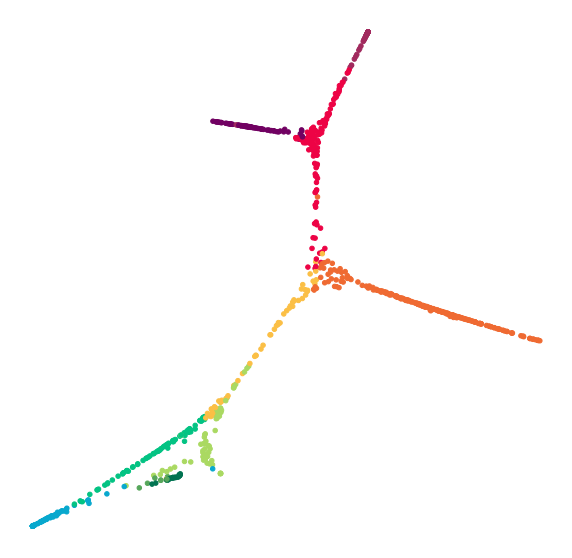

In [227]:
cvsopts = dict(plot_height=400, plot_width=400)
colors = {'CA': grove2[7],
        'CA1-Sub': grove2[9],
        'CA2-3-4': grove2[8],
        'Granule': grove2[6],
        'ImmGranule1': grove2[6],
        'ImmGranule2': grove2[6],
        'Nbl1': grove2[5],
        'Nbl2': grove2[5],
        'nIPC': grove2[4],
        'RadialGlia': grove2[3],
        'RadialGlia2': grove2[3],
        'GlialProg': grove2[2],
        'OPC': grove2[1],
        'ImmAstro': grove2[0]}

forcedirected, nodes, edges = layout_graph(sub_data, 10, 5)

In [55]:
%%script echo for all cells skipping
fd_d = graphplot(forcedirected, connect_edges(forcedirected,edges), "Force-directed")
fd_b = graphplot(forcedirected, hammer_bundle(forcedirected,edges), "Force-directed, bundled") 

tf.Images(fd_d,fd_b).cols(2)

for all cells skipping


In [56]:
%%script echo for all cells skipping
all_data = pd.concat([celltime, cellembedding], axis=1)

# Caution: this roughly takes 20+ minutes for 18140 cells.
forcedirected_all, nodes_all, edges_all = layout_graph(all_data, 10, 5)

for all cells skipping


ForceAtlas2 layout

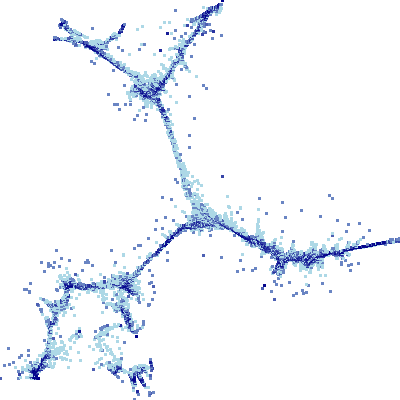

In [247]:
%%script echo for all cells skipping
tf.Images(nodesplot(forcedirected_all, "ForceAtlas2 layout"))

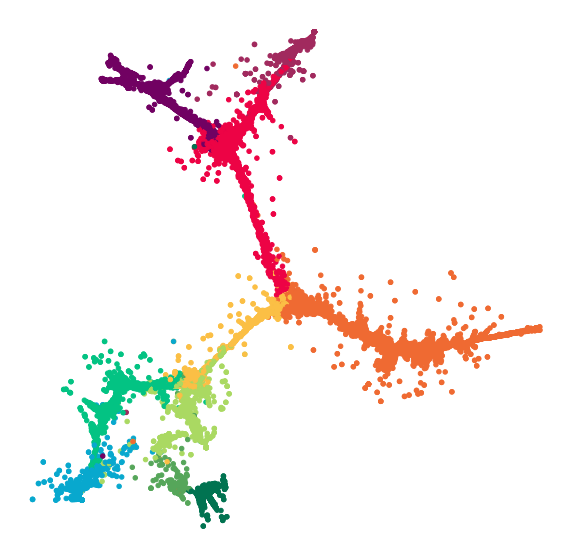

In [254]:
%%script echo for all cells skipping
fig, ax = plt.subplots(figsize=(10,10))
#plt.plot(HB.x, HB.y, lw=0.1, c='lightblue', alpha = 1, zorder=1)
plt.scatter(forcedirected_all.x, forcedirected_all.y, c=all_data['clusters'].map(colors), s = 20, zorder=2)
plt.axis('off')
plt.show()

In [57]:
colors = {'CA': grove2[7],
        'CA1-Sub': grove2[9],
        'CA2-3-4': grove2[8],
        'Granule': grove2[6],
        'ImmGranule1': grove2[6],
        'ImmGranule2': grove2[6],
        'Nbl1': grove2[5],
        'Nbl2': grove2[5],
        'nIPC': grove2[4],
        'RadialGlia': grove2[3],
        'RadialGlia2': grove2[3],
        'GlialProg': grove2[2],
        'OPC': grove2[1],
        'ImmAstro': grove2[0]}
colormap = list(sub_data['clusters'].map(colors))

<img src='data:image/png;base64,iVBORw0KGgoAAAANSUhEUgAAAEAAAABACAYAAACqaXHeAAAABHNCSVQICAgIfAhkiAAAAAlwSFlz
AAAB+wAAAfsBxc2miwAAABl0RVh0U29mdHdhcmUAd3d3Lmlua3NjYXBlLm9yZ5vuPBoAAA6zSURB
VHic7ZtpeFRVmsf/5966taWqUlUJ2UioBBJiIBAwCZtog9IOgjqACsogKtqirT2ttt069nQ/zDzt
tI4+CrJIREFaFgWhBXpUNhHZQoKBkIUASchWla1S+3ar7r1nPkDaCAnZKoQP/D7mnPOe9/xy76n3
nFSAW9ziFoPFNED2LLK5wcyBDObkb8ZkxuaoSYlI6ZcOKq1eWFdedqNzGHQBk9RMEwFAASkk0Xw3
ETacDNi2vtvc7L0ROdw0AjoSotQVkKSvHQz/wRO1lScGModBFbDMaNRN1A4tUBCS3lk7BWhQkgpD
lG4852/+7DWr1R3uHAZVQDsbh6ZPN7CyxUrCzJMRouusj0ipRwD2uKm0Zn5d2dFwzX1TCGhnmdGo
G62Nna+isiUqhkzuKrkQaJlPEv5mFl2fvGg2t/VnzkEV8F5ioioOEWkLG86fvbpthynjdhXYZziQ
x1hC9J2NFyi8vCTt91Fh04KGip0AaG9zuCk2wQCVyoNU3Hjezee9bq92duzzTmxsRJoy+jEZZZYo
GTKJ6SJngdJqAfRzpze0+jHreUtPc7gpBLQnIYK6BYp/uGhw9YK688eu7v95ysgshcg9qSLMo3JC
4jqLKQFBgdKDPoQ+Pltb8dUyQLpeDjeVgI6EgLIQFT5tEl3rn2losHVsexbZ3EyT9wE1uGdkIPcy
BGxn8QUq1QrA5nqW5i2tLqvrrM9NK6AdkVIvL9E9bZL/oyfMVd/jqvc8LylzRBKDJSzIExwhQzuL
QYGQj4rHfFTc8mUdu3E7yoLtbTe9gI4EqVgVkug2i5+uXGo919ixbRog+3fTbQ8qJe4ZOYNfMoTI
OoshUNosgO60AisX15aeI2PSIp5KiFLI9ubb1vV3Qb2ltwLakUCDAkWX7/nHKRmmGIl9VgYsUhJm
2NXjKYADtM1ygne9QQDIXlk49FBstMKx66D1v4+XuQr7vqTe0VcBHQlRWiOCbmmSYe2SqtL6q5rJ
zsTb7lKx3FKOYC4DoqyS/B5bvLPxvD9Qtf6saxYLQGJErmDOdOMr/zo96km1nElr8bmPOBwI9COv
HnFPRIwmkSOv9kcAS4heRsidOkpeWBgZM+UBrTFAXNYL5Vf2ii9c1trNzpYdaoVil3WIc+wdk+gQ
noie3ecCcxt9ITcLAPWt/laGEO/9U6PmzZkenTtsSMQ8uYywJVW+grCstAvCIaAdArAsIWkRDDs/
KzLm2YcjY1Lv0UdW73HabE9n6V66cxSzfEmuJssTpKGVp+0vHq73FwL46eOjpMpbRAnNmJFrGJNu
Ukf9Yrz+3rghiumCKNXXWPhLYcjxGsIpoCMsIRoFITkW8AuyM8jC1+/QLx4bozCEJIq38+1rtpR6
V/yzb8eBlRb3fo5l783N0CWolAzJHaVNzkrTzlEp2bQ2q3TC5gn6wpnoQAmwSiGh2GitnTmVMc5O
UyfKWUKCIsU7+fZDKwqdT6DDpvkzAX4/+AMFjk0tDp5GRXLpQ2MUmhgDp5gxQT8+Y7hyPsMi8uxF
71H0oebujHALECjFKaW9Lm68n18wXp2kVzIcABytD5iXFzg+WVXkegpAsOOYziqo0OkK76GyquC3
ltZAzMhhqlSNmmWTE5T6e3IN05ITFLM4GdN0vtZ3ob8Jh1NAKXFbm5PtLU/eqTSlGjkNAJjdgn/N
aedXa0tdi7+t9G0FIF49rtMSEgAs1kDLkTPO7ebm4IUWeyh1bKomXqlgMG6kJmHcSM0clYLJ8XtR
1GTnbV3F6I5wCGikAb402npp1h1s7LQUZZSMIfALFOuL3UUrfnS8+rez7v9qcold5tilgHbO1fjK
9ubb17u9oshxzMiUBKXWqJNxd+fqb0tLVs4lILFnK71H0Ind7uiPgACVcFJlrb0tV6DzxqqTIhUM
CwDf1/rrVhTa33/3pGPxJYdQ2l2cbgVcQSosdx8uqnDtbGjh9SlDVSMNWhlnilfqZk42Th2ZpLpf
xrHec5e815zrr0dfBZSwzkZfqsv+1FS1KUknUwPARVvItfKUY+cn57yP7qv07UE3p8B2uhUwLk09
e0SCOrK+hbdYHYLjRIl71wWzv9jpEoeOHhGRrJAzyEyNiJuUqX0g2sBN5kGK6y2Blp5M3lsB9Qh4
y2Ja6x6+i0ucmKgwMATwhSjdUu49tKrQ/pvN5d53ml2CGwCmJipmKjgmyuaXzNeL2a0AkQ01Th5j
2DktO3Jyk8f9vcOBQHV94OK+fPumJmvQHxJoWkaKWq9Vs+yUsbq0zGT1I4RgeH2b5wef7+c7bl8F
eKgoHVVZa8ZPEORzR6sT1BzDUAD/d9F78e2Tzv99v8D+fLVTqAKAsbGamKey1Mt9Ann4eH3gTXTz
idWtAJ8PQWOk7NzSeQn/OTHDuEikVF1R4z8BQCy+6D1aWRfY0tTGG2OM8rRoPaeIj5ZHzJxszElN
VM8K8JS5WOfv8mzRnQAKoEhmt8gyPM4lU9SmBK1MCQBnW4KONT86v1hZ1PbwSXPw4JWussVjtH9Y
NCoiL9UoH/6PSu8jFrfY2t36erQHXLIEakMi1SydmzB31h3GGXFDFNPaK8Rme9B79Ixrd0WN+1ij
NRQ/doRmuFLBkHSTOm5GruG+pFjFdAmorG4IXH1Qua6ASniclfFtDYt+oUjKipPrCQB7QBQ2lrgP
fFzm+9XWUtcqJ3/5vDLDpJ79XHZk3u8nGZ42qlj1+ydtbxysCezrydp6ugmipNJ7WBPB5tydY0jP
HaVNzs3QzeE4ZpTbI+ZbnSFPbVOw9vsfnVvqWnirPyCNGD08IlqtYkh2hjZ5dErEQzoNm+6ykyOt
Lt5/PQEuSRRKo22VkydK+vvS1XEKlhCJAnsqvcVvH7f/ZU2R67eXbMEGAMiIV5oWZWiWvz5Fv2xG
sjqNJQRvn3Rs2lji/lNP19VjAQDgD7FHhujZB9OGqYxRkZxixgRDVlqS6uEOFaJUVu0rPFzctrnF
JqijImVp8dEKVWyUXDk92zAuMZ6bFwpBU1HrOw6AdhQgUooChb0+ItMbWJitSo5Ws3IAOGEOtL53
0vHZih9sC4vtofZ7Qu6523V/fmGcds1TY3V36pUsBwAbSlxnVh2xLfAD/IAIMDf7XYIkNmXfpp2l
18rkAJAy9HKFaIr/qULkeQQKy9zf1JgDB2uaeFNGijo5QsUyacNUUTOnGO42xSnv4oOwpDi1zYkc
efUc3I5Gk6PhyTuVKaOGyLUAYPGIoY9Pu/atL/L92+4q9wbflRJ2Trpm/jPjdBtfnqB/dIThcl8A
KG7hbRuKnb8qsQsVvVlTrwQAQMUlf3kwJI24Z4JhPMtcfng5GcH49GsrxJpGvvHIaeem2ma+KSjQ
lIwUdYyCY8j4dE1KzijNnIP2llF2wcXNnsoapw9XxsgYAl6k+KzUXbi2yP3KR2ecf6z3BFsBICdW
nvnIaG3eHybqX7vbpEqUMT+9OL4Qpe8VON7dXuFd39v19FoAABRVePbGGuXTszO0P7tu6lghUonE
llRdrhArLvmKdh9u29jcFiRRkfLUxBiFNiqSU9icoZQHo5mYBI1MBgBH6wMNb+U7Pnw337H4gi1Y
ciWs+uks3Z9fztUvfzxTm9Ne8XXkvQLHNytOOZeiD4e0PgkAIAYCYknKUNUDSXEKzdWNpnil7r4p
xqkjTarZMtk/K8TQ6Qve78qqvXurGwIJqcOUKfUWHsm8KGvxSP68YudXq4pcj39X49uOK2X142O0
Tz5/u/7TVybqH0rSya6ZBwD21/gubbrgWdDgEOx9W
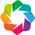

In [260]:
import holoviews as hv
from holoviews import opts
hv.extension('bokeh')

kwargs = dict(width=1000, height=1000, xaxis=None, yaxis=None)
opts.defaults(opts.Nodes(**kwargs), opts.Graph(**kwargs))

In [259]:
from holoviews.element.graphs import layout_nodes
layout_nodes(_graph, layout=nx.spring_layout, 
             kwargs={'weight':'weight', 'iterations':200, 'seed':100})

:Graph   [source,target]   (weight)

In [274]:
graph = hv.Graph((edges, forcedirected), label="neuro cell velocity")
graph.opts(node_size=3, edge_line_width=0.1,
            node_line_color='gray', 
            cmap=colors, node_color='clusters',
            edge_alpha=0.1, node_alpha=1)

:Graph   [source,target]   (weight)

In [276]:
%%time 
from holoviews.operation.datashader import datashade, bundle_graph
bundled = bundle_graph(graph)
bundled

CPU times: user 17.2 s, sys: 7.35 s, total: 24.6 s
Wall time: 18.9 s


:Graph   [source,target]   (weight)

In [291]:
overlay = datashade(bundled, width=800, height=800) * bundled.select(pseudotime=(0,0.05))
overlay.opts(opts.Graph(node_size=10))

:DynamicMap   []
   :Overlay
      .RGB.Neuro_cell_velocity   :RGB   [x,y]   (R,G,B,A)
      .Graph.Neuro_cell_velocity :Graph   [source,target]   (weight)